<a href="https://colab.research.google.com/github/JhulianaM/Mammography/blob/master/Interpolacionx4comp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files
files.upload()  # Sube el archivo kaggle.json

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d kmader/mias-mammography
!unzip mias-mammography.zip -d mias

Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/kmader/mias-mammography
License(s): other
100% 311M/312M [00:03<00:00, 130MB/s]
100% 312M/312M [00:03<00:00, 84.5MB/s]
Archive:  mias-mammography.zip
  inflating: mias/Info.txt           
  inflating: mias/all-mias.tar.gz    
  inflating: mias/all-mias/Info.txt  
  inflating: mias/all-mias/Licence.txt  
  inflating: mias/all-mias/README    
  inflating: mias/all-mias/mdb001.pgm  
  inflating: mias/all-mias/mdb002.pgm  
  inflating: mias/all-mias/mdb003.pgm  
  inflating: mias/all-mias/mdb004.pgm  
  inflating: mias/all-mias/mdb005.pgm  
  inflating: mias/all-mias/mdb006.pgm  
  inflating: mias/all-mias/mdb007.pgm  
  inflating: mias/all-mias/mdb008.pgm  
  inflating: mias/all-mias/mdb009.pgm  
  inflating: mias/all-mias/mdb010.pgm  
  inflating: mias/all-mias/mdb011.pgm  
  inflating: mias/all-mias/mdb012.pgm  
  inflating: mias/all-mias/mdb013.pgm  
  inflating: mias/all-mias/mdb014.pgm  
  inflating: mias/

Evaluando método de interpolación: Nearest


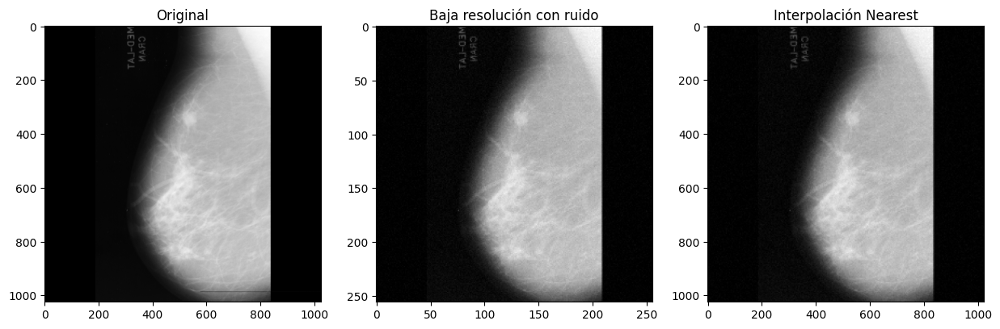

Imagen 1 - PSNR: 30.51, SSIM: 0.7682


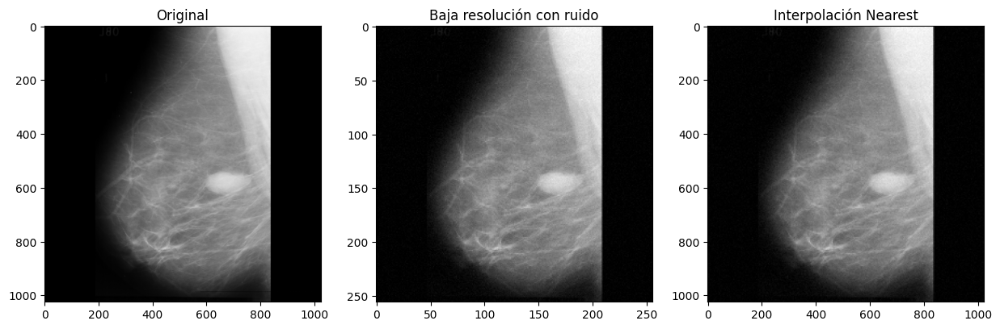

Imagen 2 - PSNR: 30.66, SSIM: 0.7526


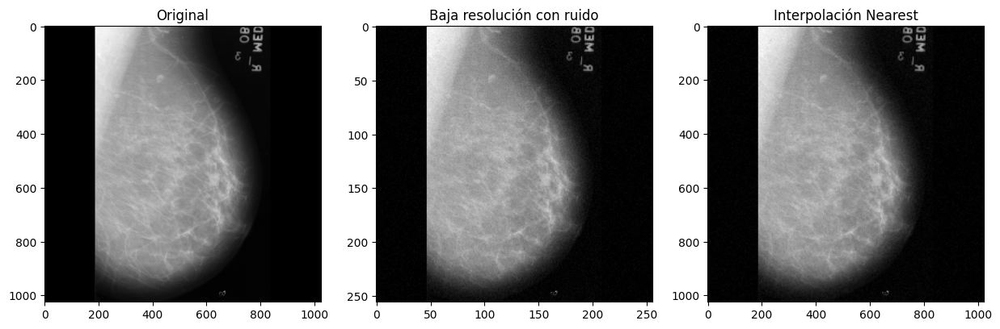

Imagen 3 - PSNR: 33.49, SSIM: 0.7692


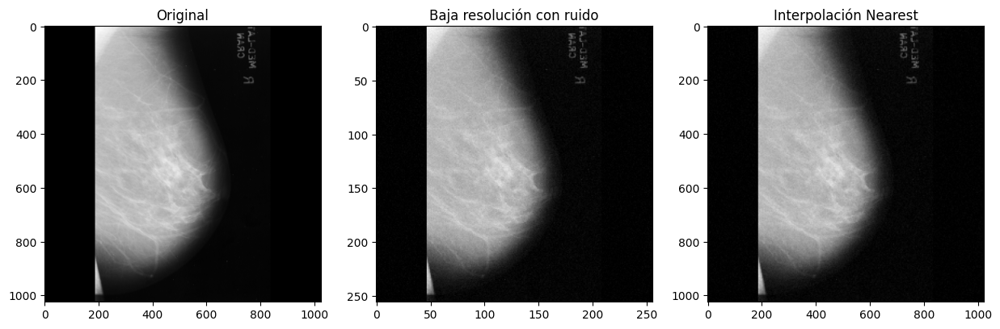

Imagen 4 - PSNR: 33.44, SSIM: 0.7775


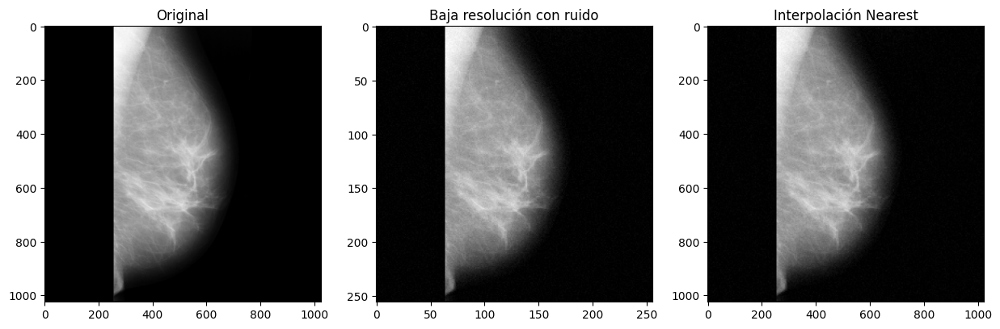

Imagen 5 - PSNR: 37.22, SSIM: 0.7273
PSNR promedio Nearest: 33.06, SSIM promedio Nearest: 0.7589

Evaluando método de interpolación: Linear


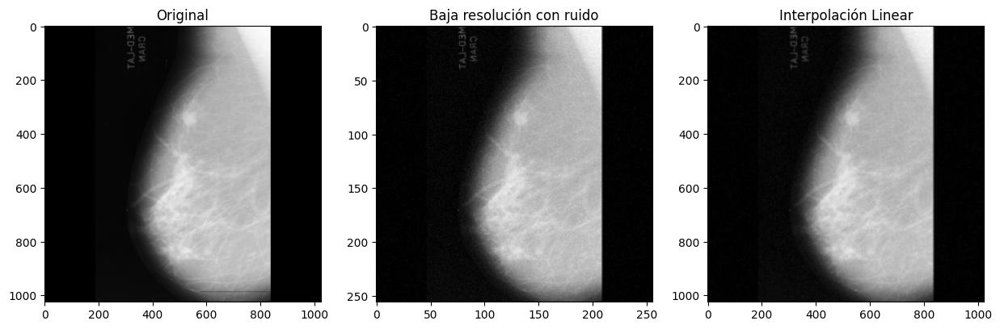

Imagen 1 - PSNR: 32.03, SSIM: 0.8278


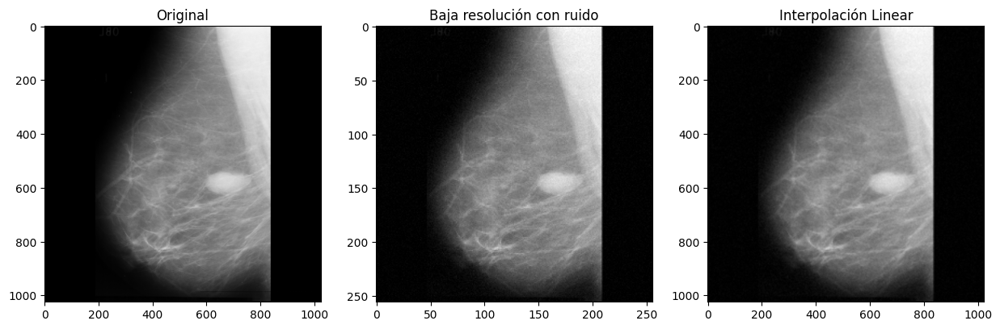

Imagen 2 - PSNR: 32.11, SSIM: 0.8096


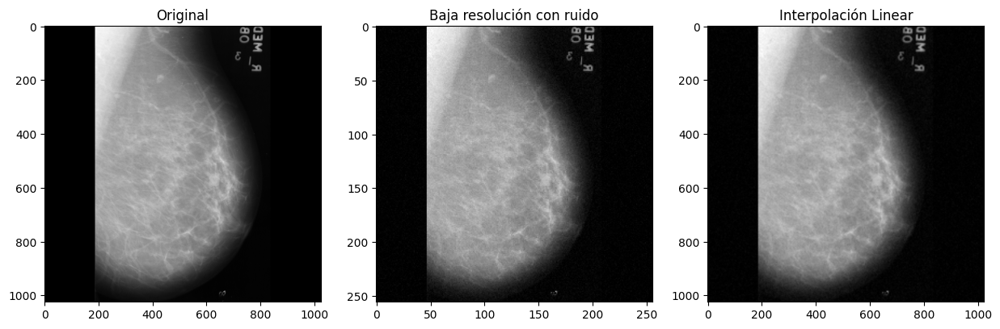

Imagen 3 - PSNR: 36.04, SSIM: 0.8287


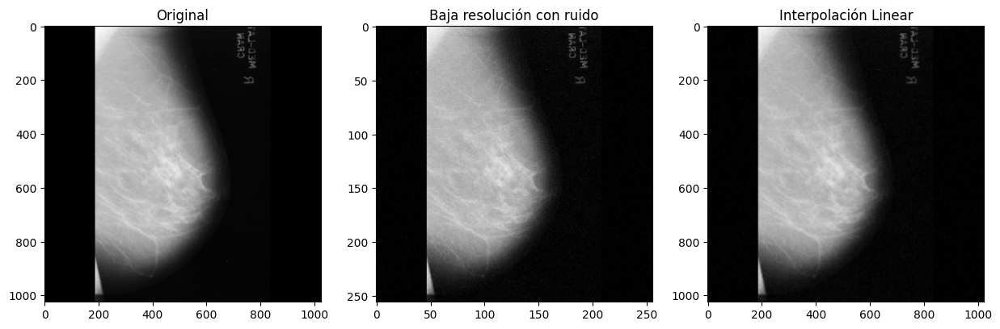

Imagen 4 - PSNR: 35.99, SSIM: 0.8349


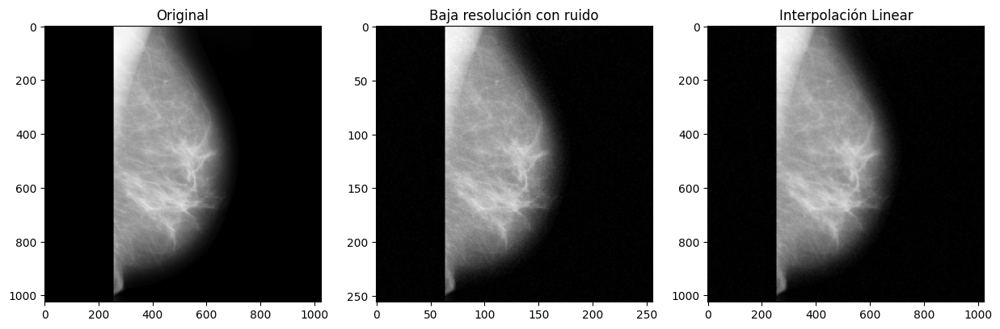

Imagen 5 - PSNR: 37.29, SSIM: 0.7730
PSNR promedio Linear: 34.69, SSIM promedio Linear: 0.8148

Evaluando método de interpolación: Cubic


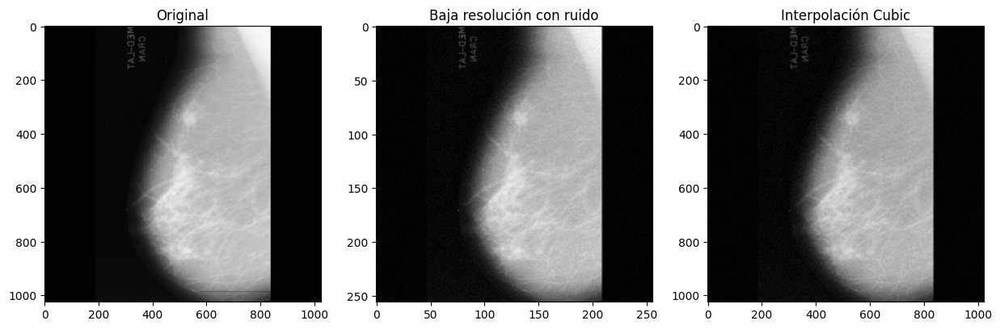

Imagen 1 - PSNR: 32.14, SSIM: 0.7966


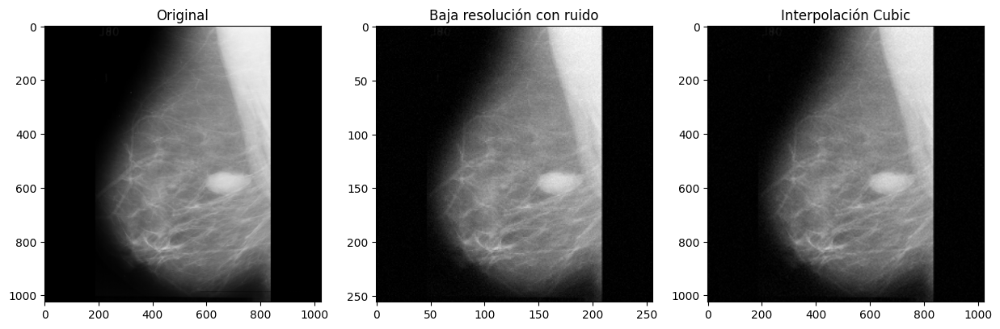

Imagen 2 - PSNR: 32.18, SSIM: 0.7801


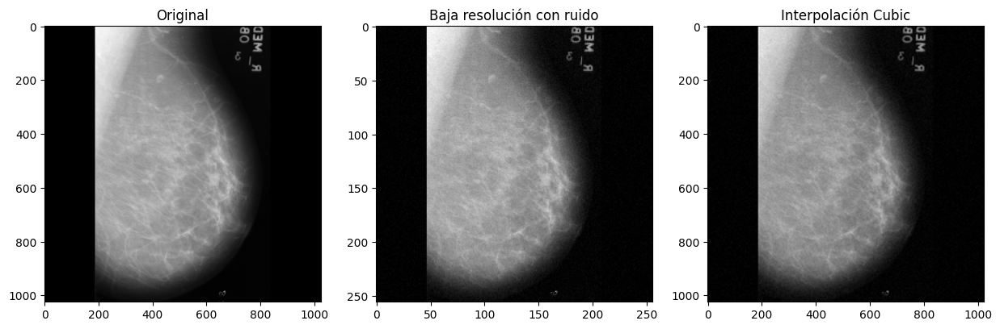

Imagen 3 - PSNR: 35.51, SSIM: 0.7976


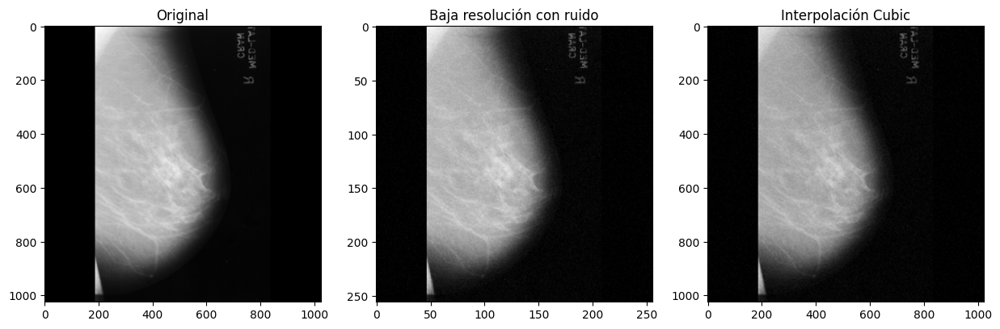

Imagen 4 - PSNR: 35.44, SSIM: 0.8032


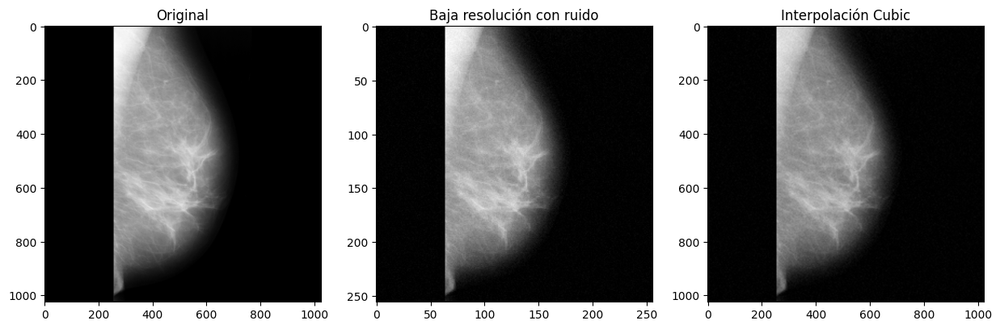

Imagen 5 - PSNR: 36.67, SSIM: 0.7403
PSNR promedio Cubic: 34.39, SSIM promedio Cubic: 0.7836

Evaluando método de interpolación: Lanczos4


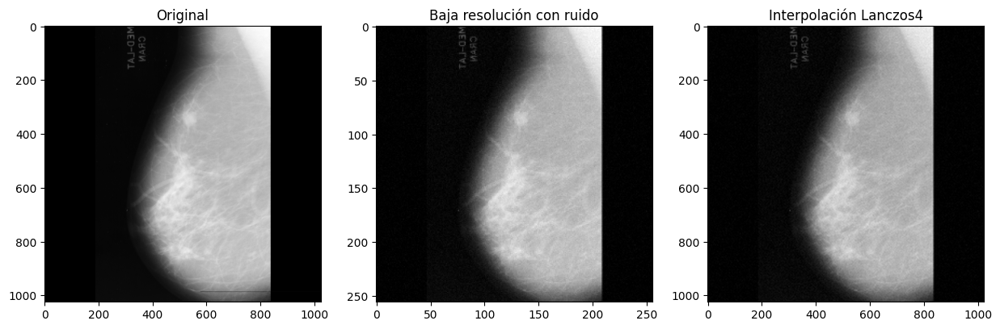

Imagen 1 - PSNR: 32.09, SSIM: 0.7831


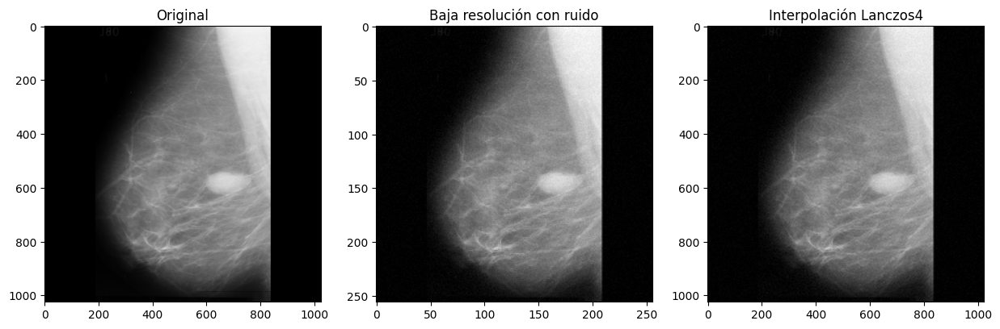

Imagen 2 - PSNR: 32.12, SSIM: 0.7663


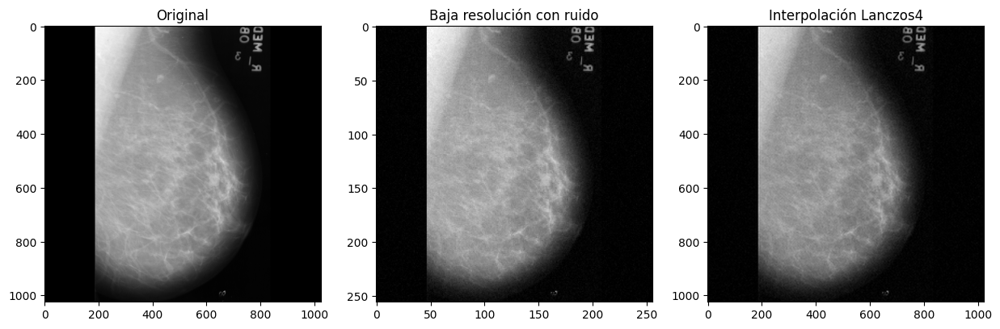

Imagen 3 - PSNR: 35.22, SSIM: 0.7816


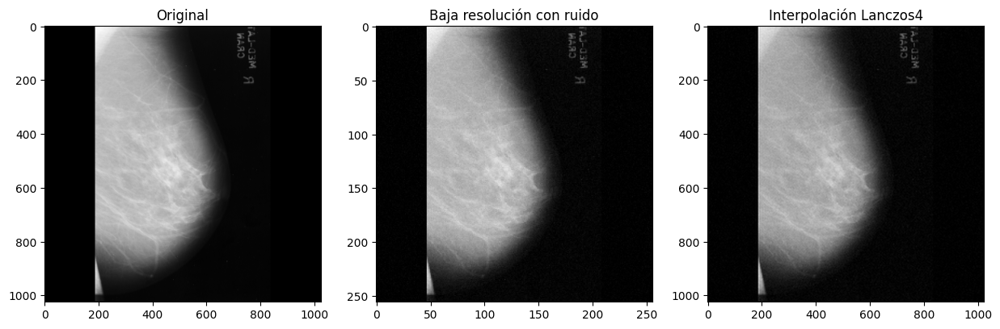

Imagen 4 - PSNR: 35.14, SSIM: 0.7871


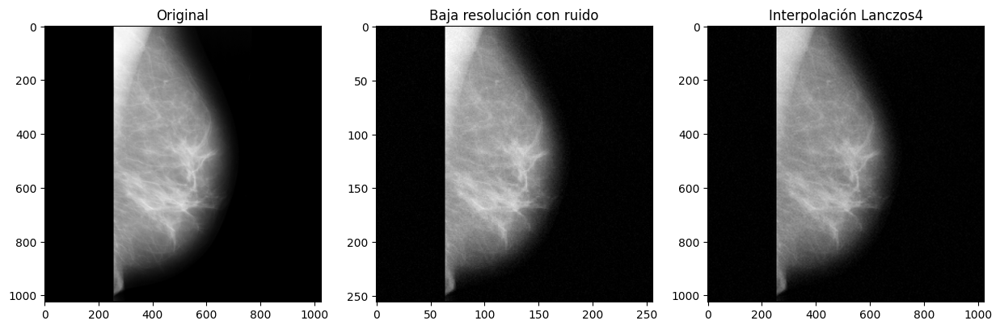

Imagen 5 - PSNR: 36.35, SSIM: 0.7227
PSNR promedio Lanczos4: 34.18, SSIM promedio Lanczos4: 0.7682



In [5]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Directorio de imágenes
data_dir = "mias/all-mias/"

# Cargar imágenes
images = []
for file_name in os.listdir(data_dir):
    if file_name.endswith('.pgm'):
        img_path = os.path.join(data_dir, file_name)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        images.append(img)

# Normalización y preparación
images = np.array(images)
images = images.astype('float32') / 255.0

# Convertir imágenes en escala de grises a imágenes RGB
val_images = images[:10]
val_images_rgb = [np.stack((img,)*3, axis=-1) for img in val_images]

# Realizar la bajada de resolución
val_images_resized = [cv2.resize(img, (img.shape[1]//4, img.shape[0]//4)) for img in val_images_rgb]

# Añadir ruido gaussiano a las imágenes de baja resolución
noise_std = 0.02
val_images_noisy = [img + noise_std * np.random.randn(*img.shape) for img in val_images_resized]
val_images_noisy = np.clip(val_images_noisy, 0, 1)  # Asegurarse de que los valores estén en el rango [0, 1]

# Convertir imágenes a uint8 para OpenCV
val_images_noisy_uint8 = [np.uint8(img * 255) for img in val_images_noisy]

# Métodos de interpolación en OpenCV
interpolation_methods = {
    "Nearest": cv2.INTER_NEAREST,
    "Linear": cv2.INTER_LINEAR,
    "Cubic": cv2.INTER_CUBIC,
    "Lanczos4": cv2.INTER_LANCZOS4
}

# Realizar la interpolación y la comparación
for method_name, method in interpolation_methods.items():
    print(f"Evaluando método de interpolación: {method_name}")

    psnr_values = []
    ssim_values = []

    interpolated_images = [cv2.resize(img, (img.shape[1]*4, img.shape[0]*4), interpolation=method) for img in val_images_noisy_uint8]

    for i in range(5):
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.imshow(val_images[i], cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title('Baja resolución con ruido')
        plt.imshow(cv2.cvtColor(val_images_noisy_uint8[i], cv2.COLOR_BGR2GRAY), cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title(f'Interpolación {method_name}')
        plt.imshow(cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY), cmap='gray')
        plt.show()

        # Calcular PSNR y SSIM
        original_img = (val_images[i] * 255).astype(np.uint8)
        interpolated_img_gray = cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY)

        psnr_value = compare_psnr(original_img, interpolated_img_gray)
        ssim_value = compare_ssim(original_img, interpolated_img_gray)

        psnr_values.append(psnr_value)
        ssim_values.append(ssim_value)

        print(f'Imagen {i+1} - PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')

    # Mostrar los valores promedio de PSNR y SSIM
    average_psnr = np.mean(psnr_values)
    average_ssim = np.mean(ssim_values)
    print(f'PSNR promedio {method_name}: {average_psnr:.2f}, SSIM promedio {method_name}: {average_ssim:.4f}\n')

interpolacion x4 0.03

Evaluando método de interpolación: Nearest


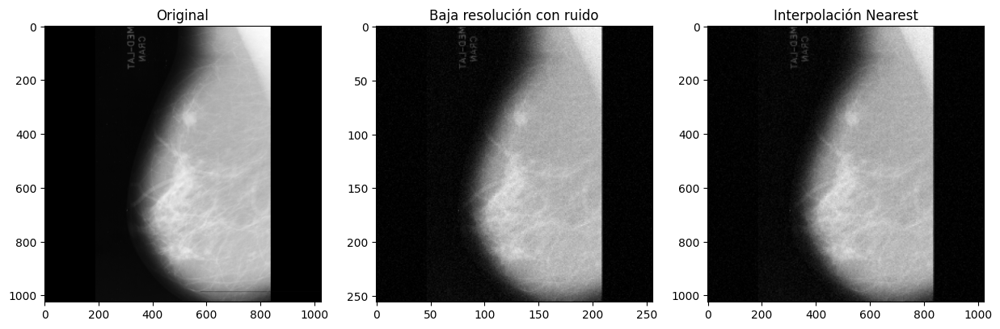

Imagen 1 - PSNR: 29.72, SSIM: 0.6459


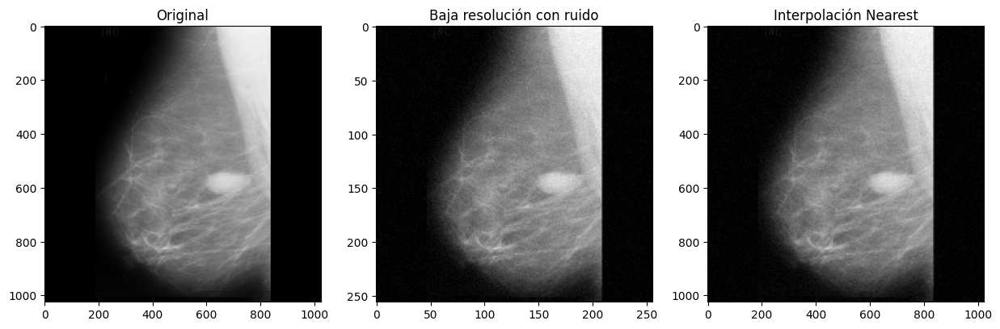

Imagen 2 - PSNR: 29.82, SSIM: 0.6252


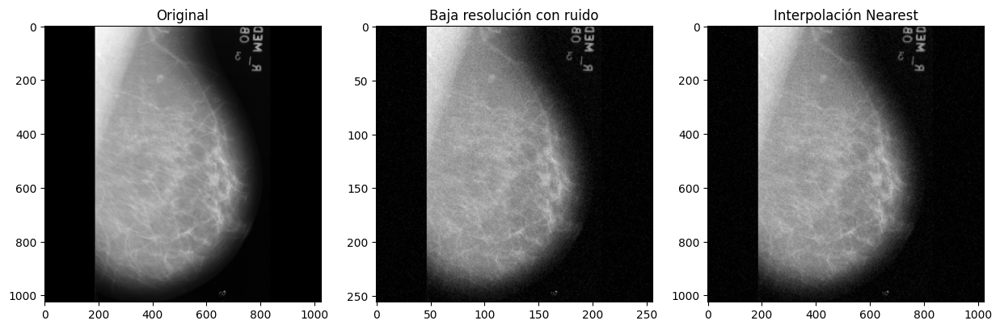

Imagen 3 - PSNR: 32.01, SSIM: 0.6446


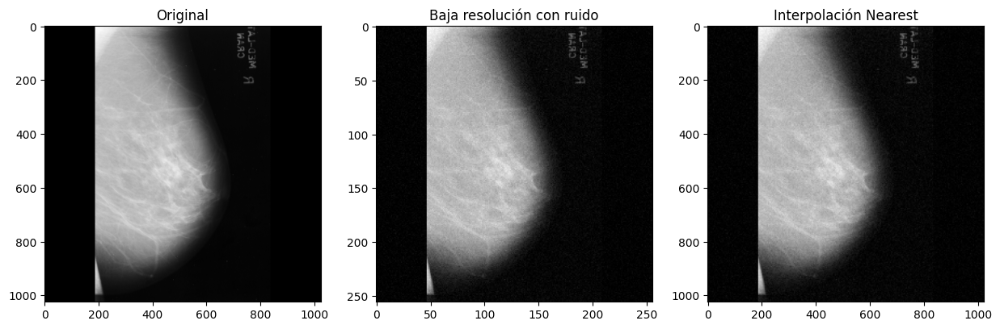

Imagen 4 - PSNR: 32.06, SSIM: 0.6538


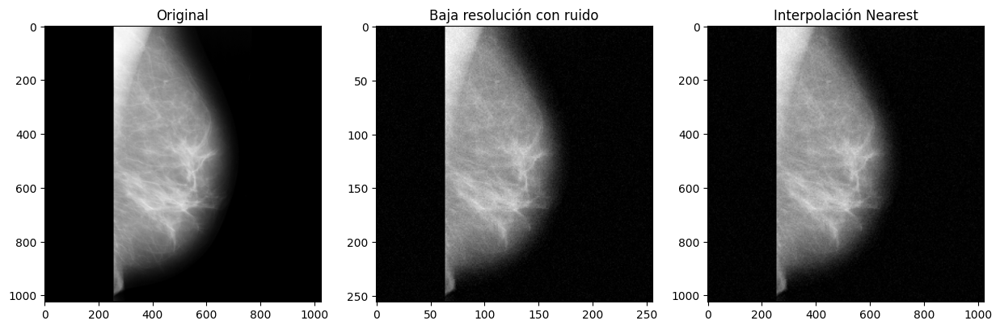

Imagen 5 - PSNR: 34.38, SSIM: 0.5763
PSNR promedio Nearest: 31.60, SSIM promedio Nearest: 0.6292

Evaluando método de interpolación: Linear


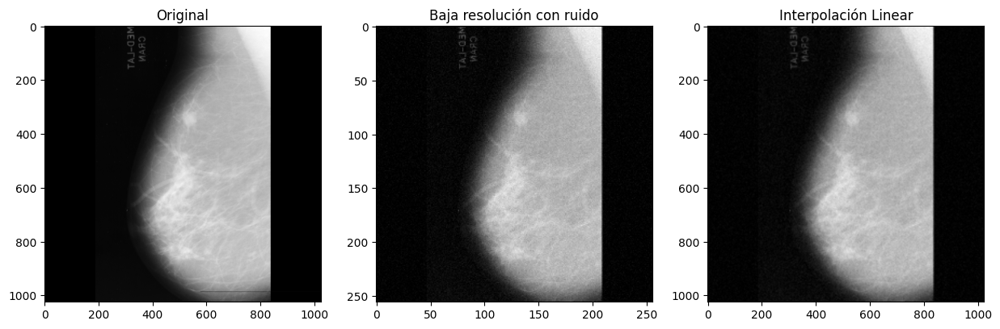

Imagen 1 - PSNR: 31.41, SSIM: 0.7328


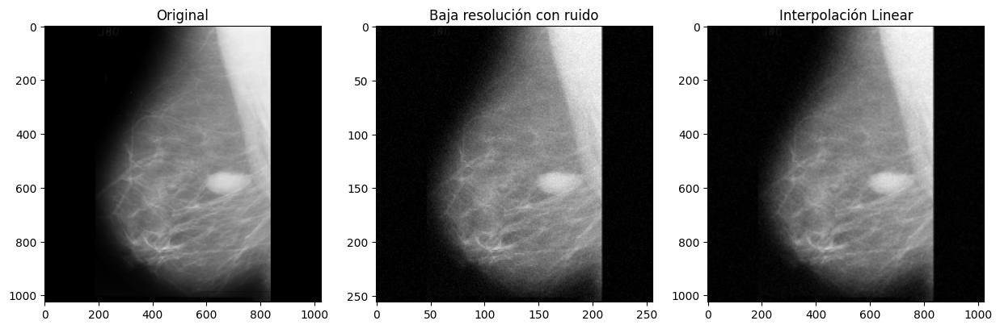

Imagen 2 - PSNR: 31.47, SSIM: 0.7069


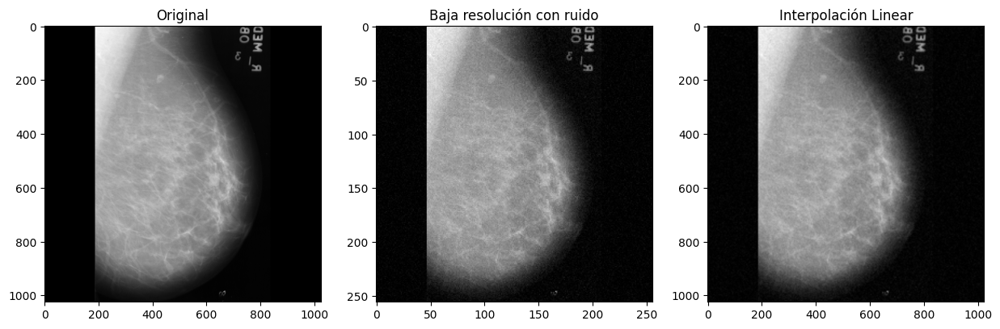

Imagen 3 - PSNR: 34.65, SSIM: 0.7316


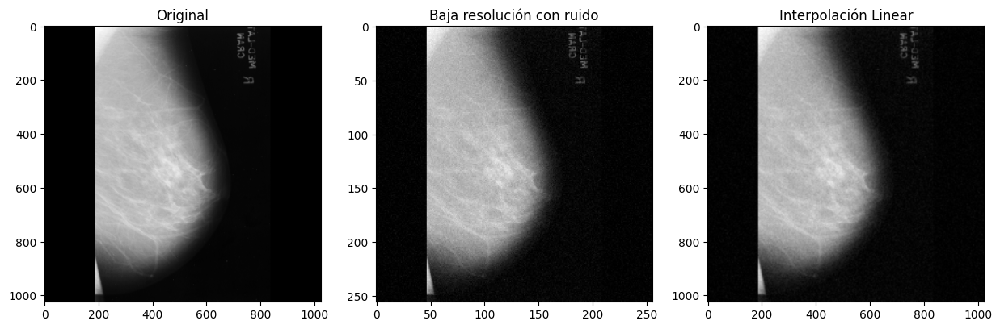

Imagen 4 - PSNR: 34.69, SSIM: 0.7391


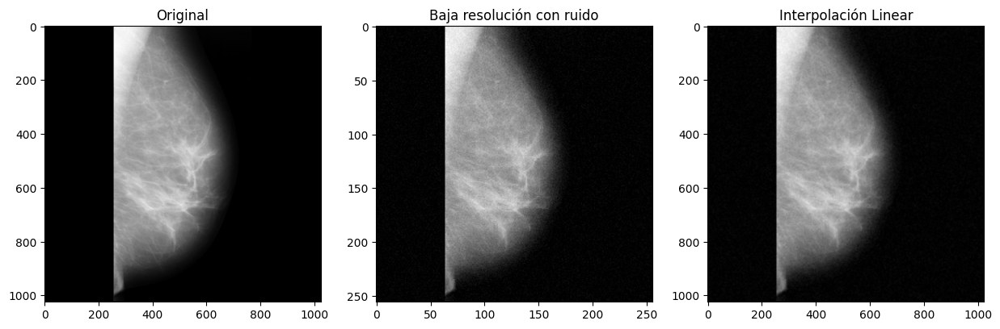

Imagen 5 - PSNR: 35.40, SSIM: 0.6376
PSNR promedio Linear: 33.53, SSIM promedio Linear: 0.7096

Evaluando método de interpolación: Cubic


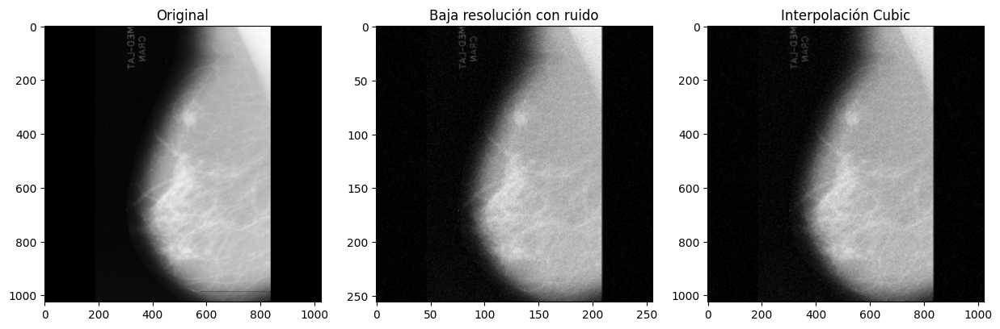

Imagen 1 - PSNR: 31.23, SSIM: 0.6877


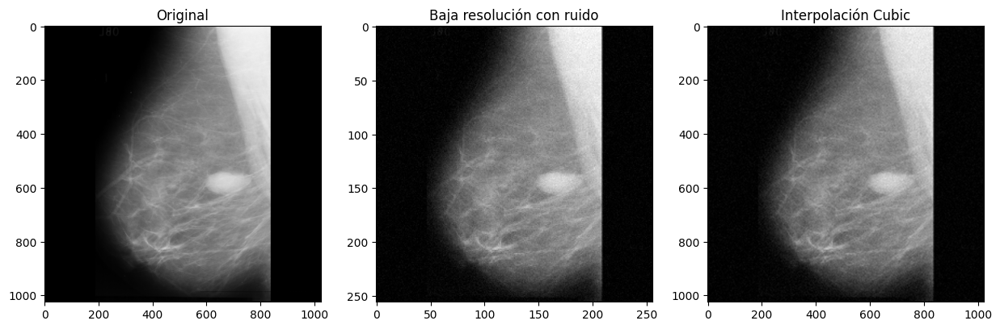

Imagen 2 - PSNR: 31.25, SSIM: 0.6647


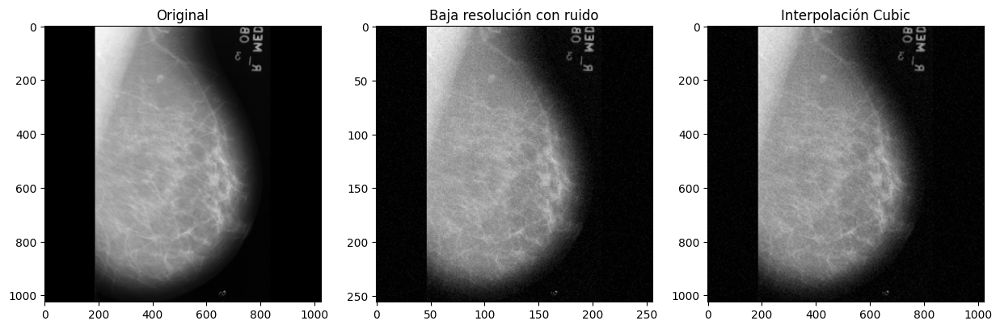

Imagen 3 - PSNR: 33.74, SSIM: 0.6867


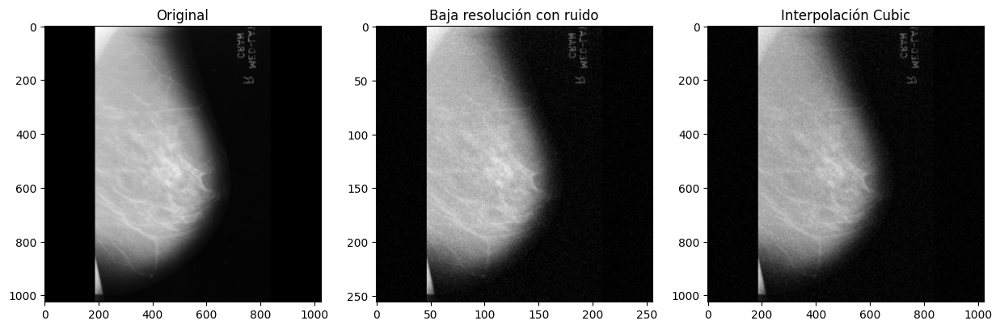

Imagen 4 - PSNR: 33.77, SSIM: 0.6934


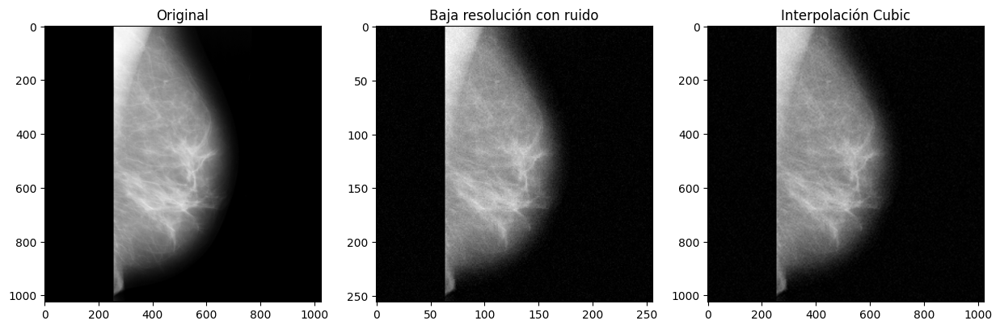

Imagen 5 - PSNR: 34.44, SSIM: 0.5981
PSNR promedio Cubic: 32.89, SSIM promedio Cubic: 0.6661

Evaluando método de interpolación: Lanczos4


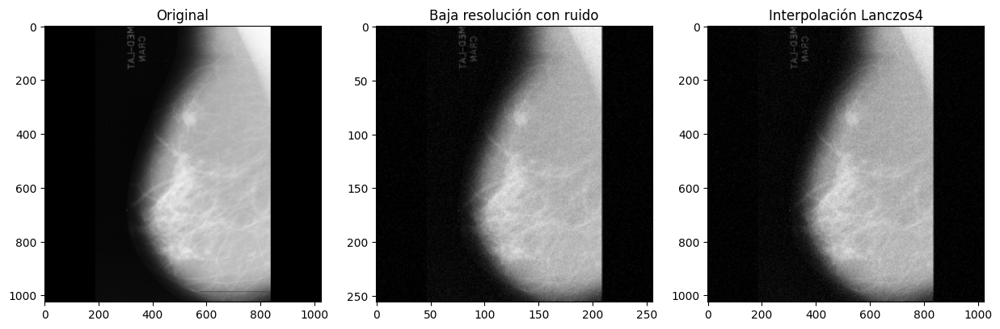

Imagen 1 - PSNR: 31.10, SSIM: 0.6688


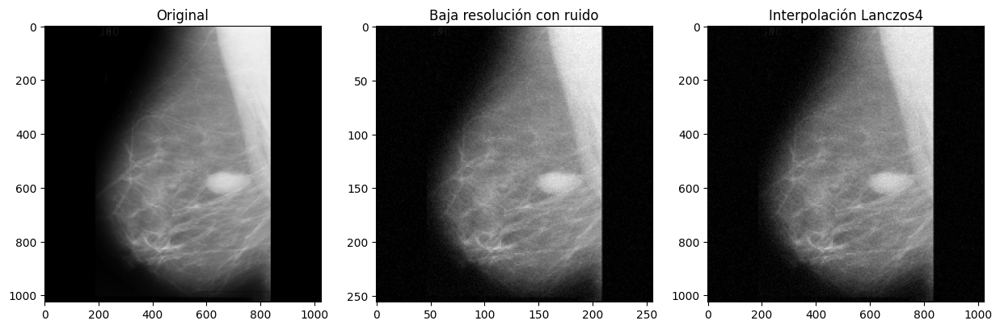

Imagen 2 - PSNR: 31.11, SSIM: 0.6451


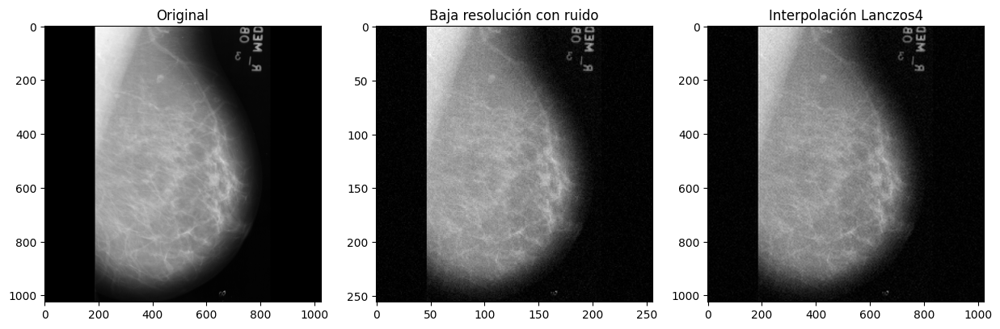

Imagen 3 - PSNR: 33.38, SSIM: 0.6653


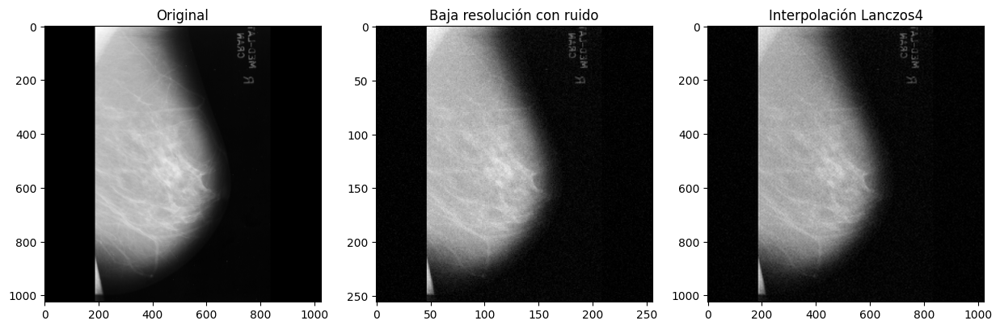

Imagen 4 - PSNR: 33.42, SSIM: 0.6726


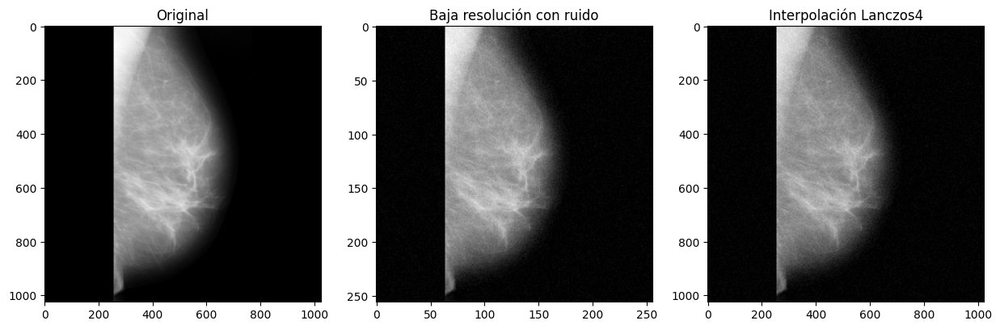

Imagen 5 - PSNR: 34.08, SSIM: 0.5763
PSNR promedio Lanczos4: 32.62, SSIM promedio Lanczos4: 0.6456



In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Directorio de imágenes
data_dir = "mias/all-mias/"

# Cargar imágenes
images = []
for file_name in os.listdir(data_dir):
    if file_name.endswith('.pgm'):
        img_path = os.path.join(data_dir, file_name)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        images.append(img)

# Normalización y preparación
images = np.array(images)
images = images.astype('float32') / 255.0

# Convertir imágenes en escala de grises a imágenes RGB
val_images = images[:10]
val_images_rgb = [np.stack((img,)*3, axis=-1) for img in val_images]

# Realizar la bajada de resolución
val_images_resized = [cv2.resize(img, (img.shape[1]//4, img.shape[0]//4)) for img in val_images_rgb]

# Añadir ruido gaussiano a las imágenes de baja resolución
noise_std = 0.03
val_images_noisy = [img + noise_std * np.random.randn(*img.shape) for img in val_images_resized]
val_images_noisy = np.clip(val_images_noisy, 0, 1)  # Asegurarse de que los valores estén en el rango [0, 1]

# Convertir imágenes a uint8 para OpenCV
val_images_noisy_uint8 = [np.uint8(img * 255) for img in val_images_noisy]

# Métodos de interpolación en OpenCV
interpolation_methods = {
    "Nearest": cv2.INTER_NEAREST,
    "Linear": cv2.INTER_LINEAR,
    "Cubic": cv2.INTER_CUBIC,
    "Lanczos4": cv2.INTER_LANCZOS4
}

# Realizar la interpolación y la comparación
for method_name, method in interpolation_methods.items():
    print(f"Evaluando método de interpolación: {method_name}")

    psnr_values = []
    ssim_values = []

    interpolated_images = [cv2.resize(img, (img.shape[1]*4, img.shape[0]*4), interpolation=method) for img in val_images_noisy_uint8]

    for i in range(5):
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.imshow(val_images[i], cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title('Baja resolución con ruido')
        plt.imshow(cv2.cvtColor(val_images_noisy_uint8[i], cv2.COLOR_BGR2GRAY), cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title(f'Interpolación {method_name}')
        plt.imshow(cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY), cmap='gray')
        plt.show()

        # Calcular PSNR y SSIM
        original_img = (val_images[i] * 255).astype(np.uint8)
        interpolated_img_gray = cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY)

        psnr_value = compare_psnr(original_img, interpolated_img_gray)
        ssim_value = compare_ssim(original_img, interpolated_img_gray)

        psnr_values.append(psnr_value)
        ssim_values.append(ssim_value)

        print(f'Imagen {i+1} - PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')

    # Mostrar los valores promedio de PSNR y SSIM
    average_psnr = np.mean(psnr_values)
    average_ssim = np.mean(ssim_values)
    print(f'PSNR promedio {method_name}: {average_psnr:.2f}, SSIM promedio {method_name}: {average_ssim:.4f}\n')

Evaluando método de interpolación: Nearest


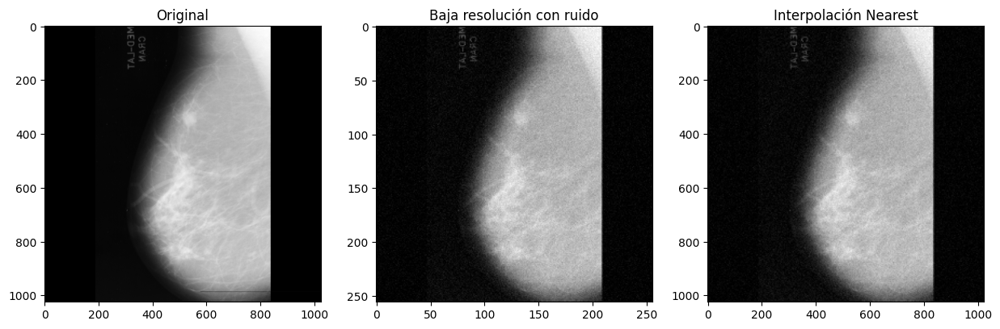

Imagen 1 - PSNR: 28.86, SSIM: 0.5480


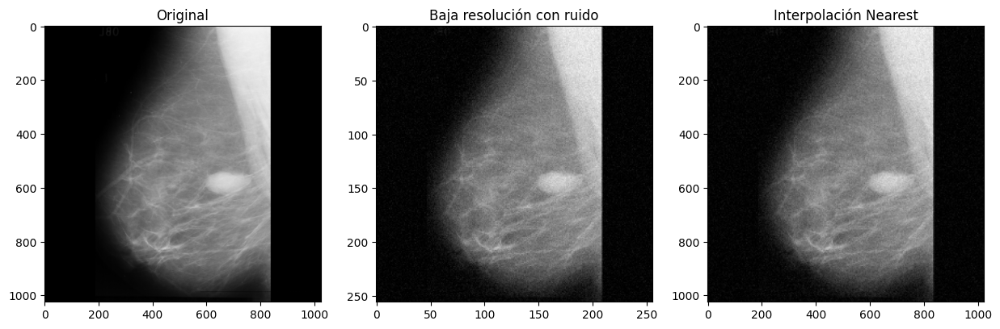

Imagen 2 - PSNR: 28.86, SSIM: 0.5238


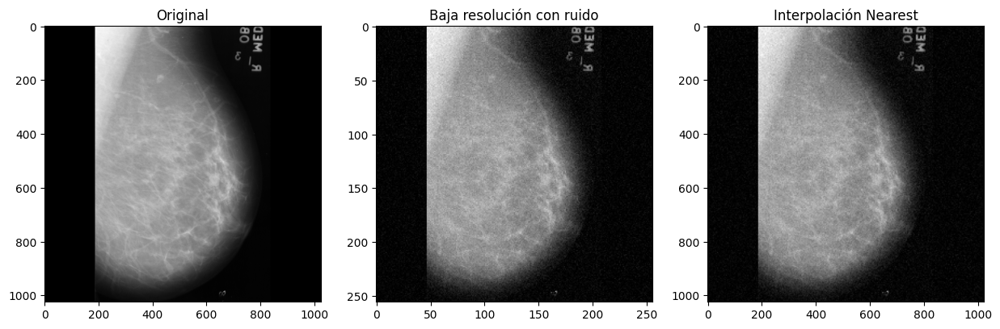

Imagen 3 - PSNR: 30.56, SSIM: 0.5413


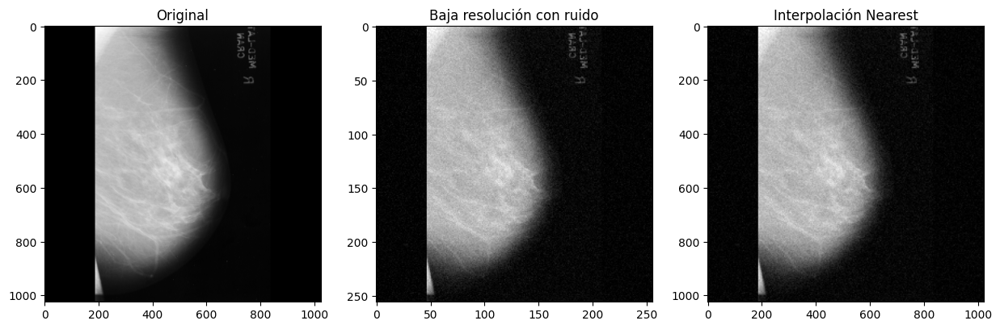

Imagen 4 - PSNR: 30.64, SSIM: 0.5508


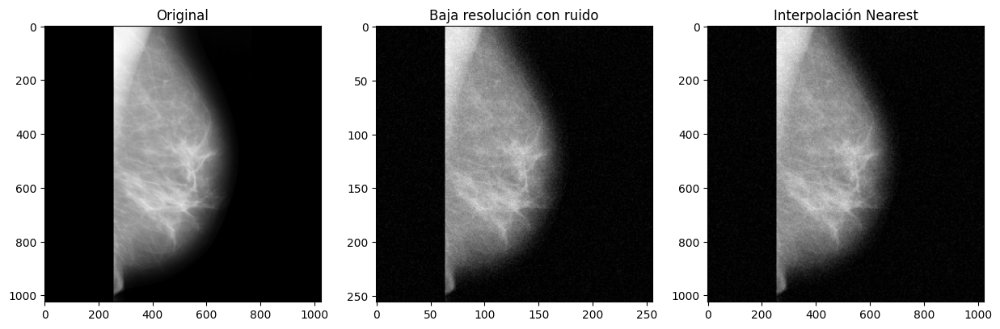

Imagen 5 - PSNR: 32.23, SSIM: 0.4651
PSNR promedio Nearest: 30.23, SSIM promedio Nearest: 0.5258

Evaluando método de interpolación: Linear


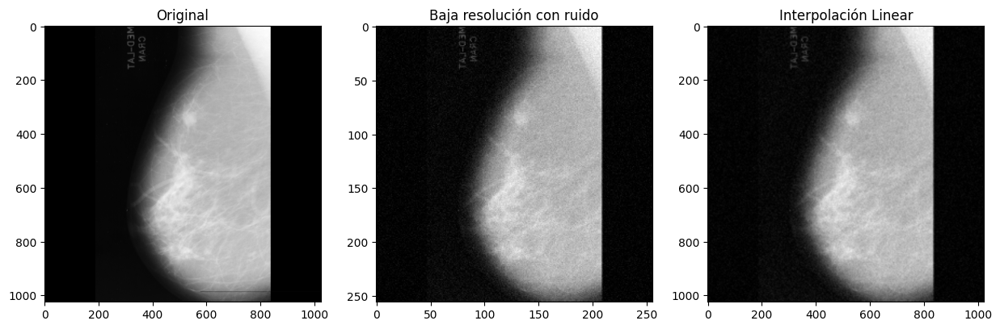

Imagen 1 - PSNR: 30.74, SSIM: 0.6569


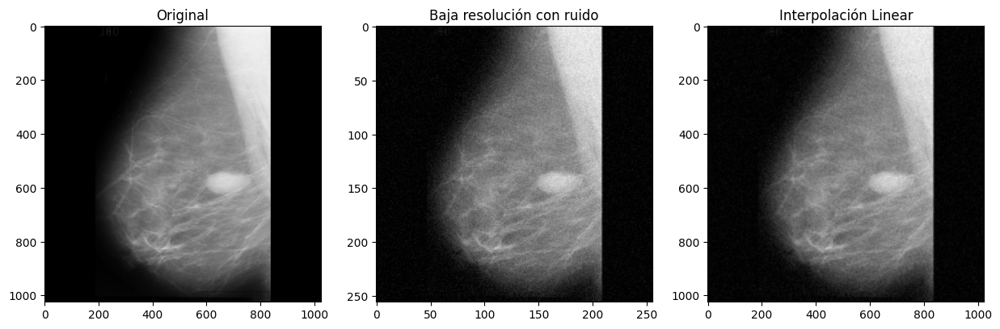

Imagen 2 - PSNR: 30.71, SSIM: 0.6259


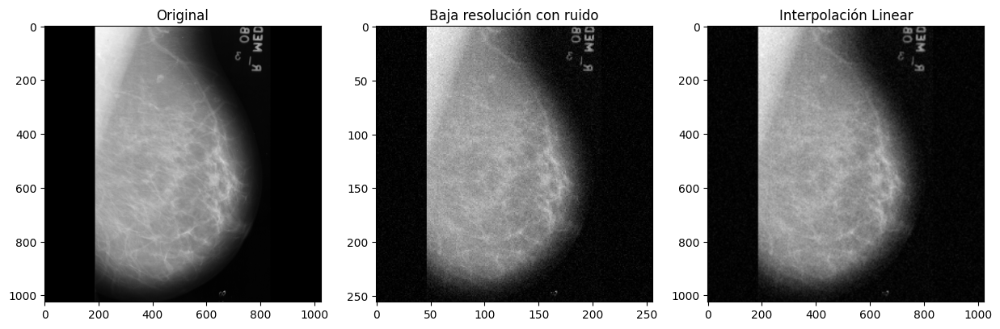

Imagen 3 - PSNR: 33.25, SSIM: 0.6505


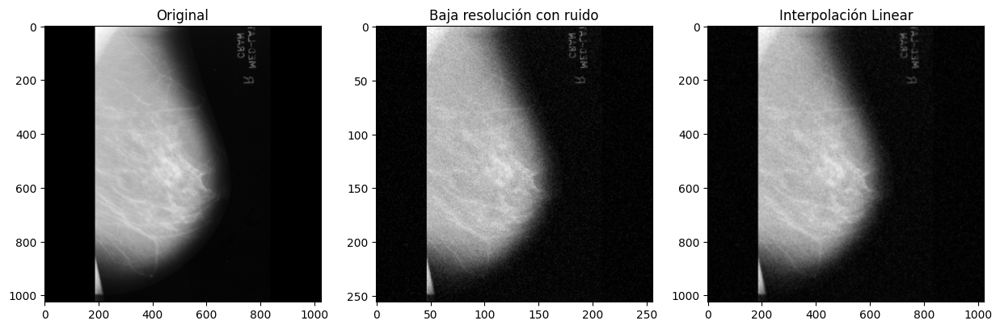

Imagen 4 - PSNR: 33.31, SSIM: 0.6579


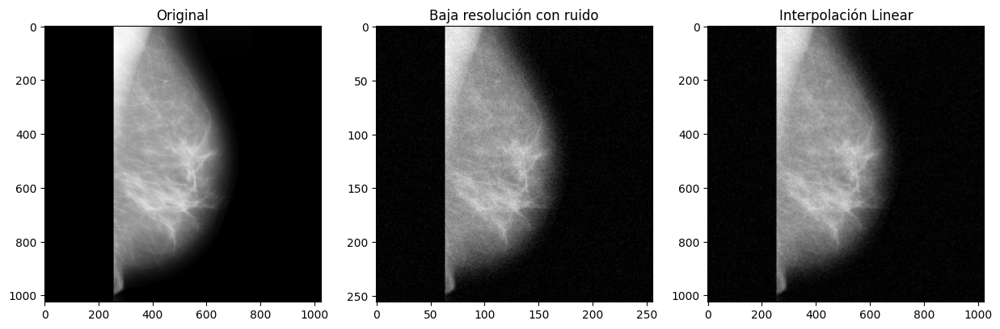

Imagen 5 - PSNR: 33.73, SSIM: 0.5387
PSNR promedio Linear: 32.35, SSIM promedio Linear: 0.6260

Evaluando método de interpolación: Cubic


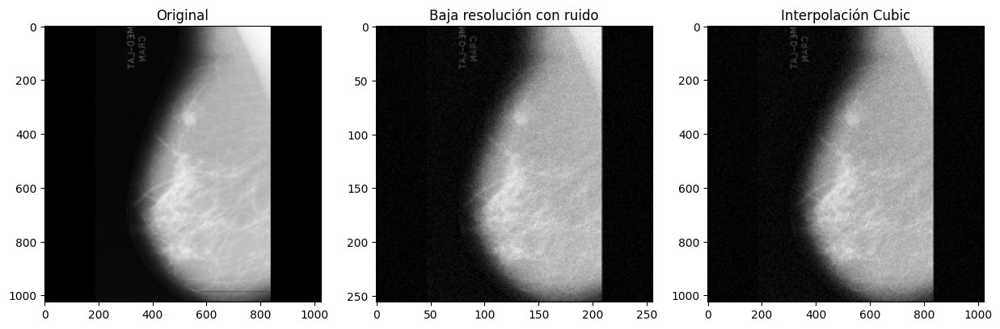

Imagen 1 - PSNR: 30.29, SSIM: 0.6002


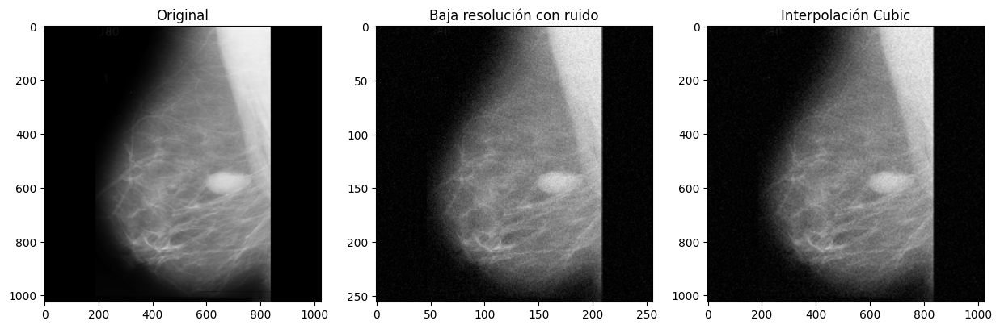

Imagen 2 - PSNR: 30.20, SSIM: 0.5732


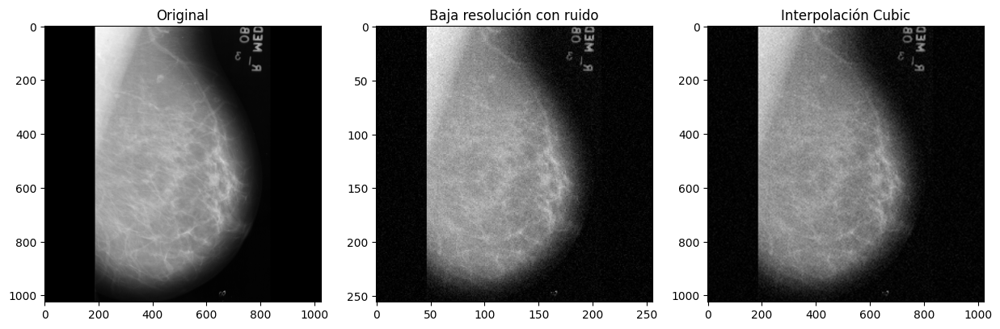

Imagen 3 - PSNR: 32.08, SSIM: 0.5937


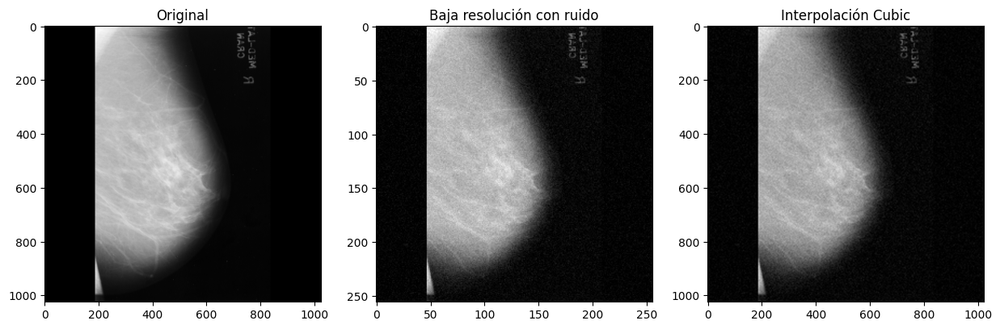

Imagen 4 - PSNR: 32.15, SSIM: 0.6011


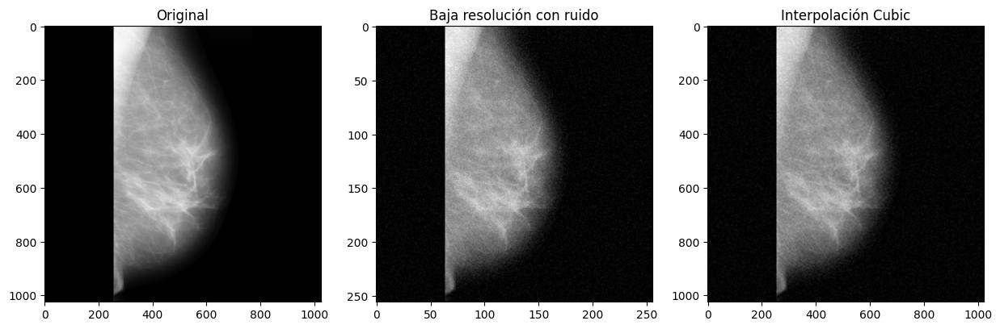

Imagen 5 - PSNR: 32.60, SSIM: 0.4945
PSNR promedio Cubic: 31.46, SSIM promedio Cubic: 0.5725

Evaluando método de interpolación: Lanczos4


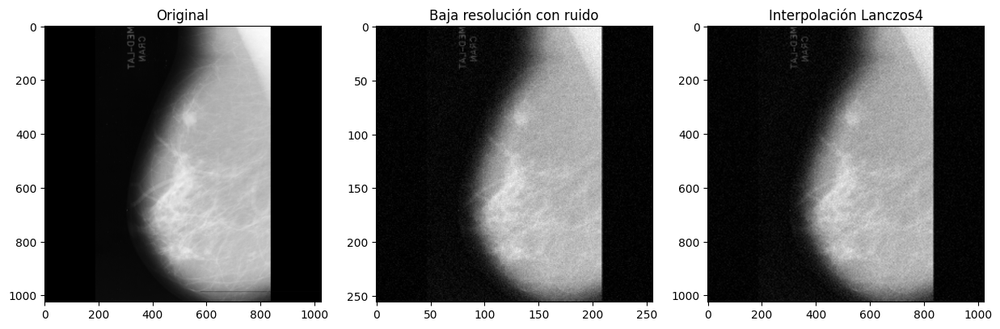

Imagen 1 - PSNR: 30.09, SSIM: 0.5776


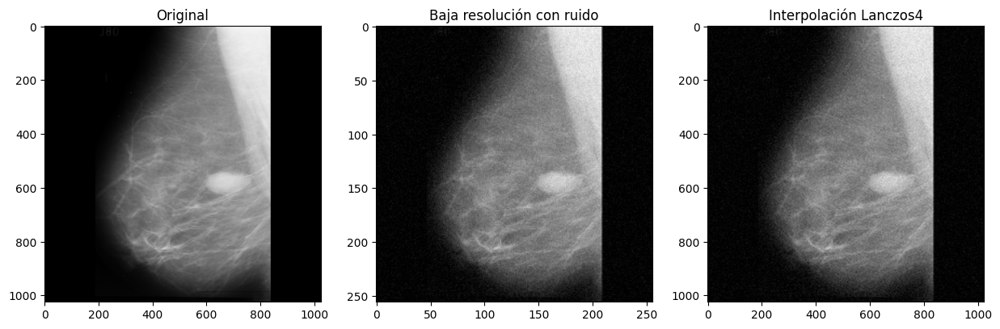

Imagen 2 - PSNR: 30.00, SSIM: 0.5501


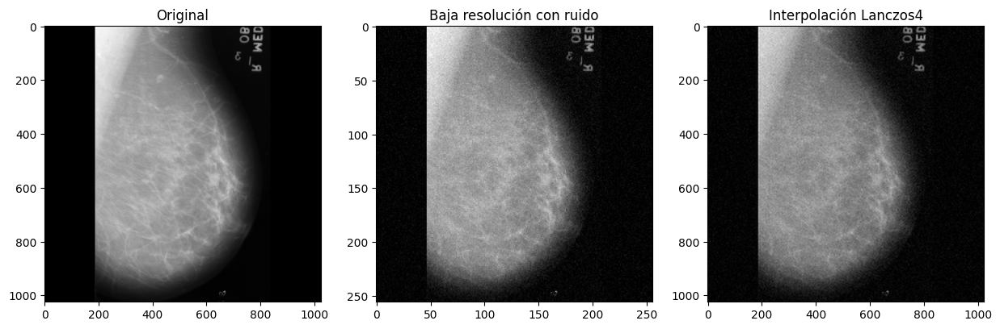

Imagen 3 - PSNR: 31.69, SSIM: 0.5688


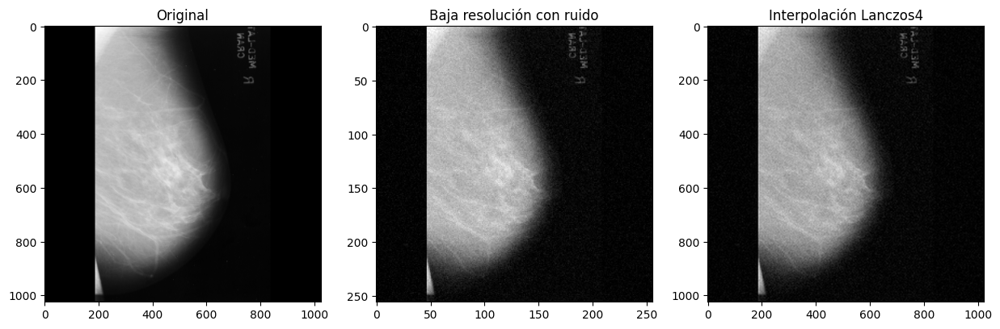

Imagen 4 - PSNR: 31.77, SSIM: 0.5774


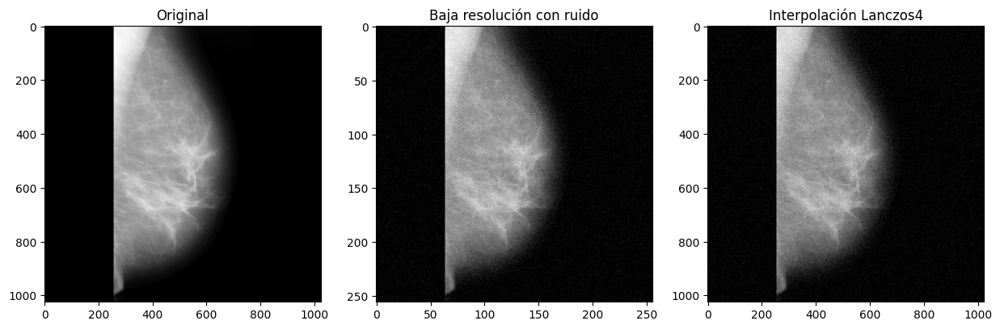

Imagen 5 - PSNR: 32.22, SSIM: 0.4711
PSNR promedio Lanczos4: 31.15, SSIM promedio Lanczos4: 0.5490



In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Directorio de imágenes
data_dir = "mias/all-mias/"

# Cargar imágenes
images = []
for file_name in os.listdir(data_dir):
    if file_name.endswith('.pgm'):
        img_path = os.path.join(data_dir, file_name)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        images.append(img)

# Normalización y preparación
images = np.array(images)
images = images.astype('float32') / 255.0

# Convertir imágenes en escala de grises a imágenes RGB
val_images = images[:10]
val_images_rgb = [np.stack((img,)*3, axis=-1) for img in val_images]

# Realizar la bajada de resolución
val_images_resized = [cv2.resize(img, (img.shape[1]//4, img.shape[0]//4)) for img in val_images_rgb]

# Añadir ruido gaussiano a las imágenes de baja resolución
noise_std = 0.04
val_images_noisy = [img + noise_std * np.random.randn(*img.shape) for img in val_images_resized]
val_images_noisy = np.clip(val_images_noisy, 0, 1)  # Asegurarse de que los valores estén en el rango [0, 1]

# Convertir imágenes a uint8 para OpenCV
val_images_noisy_uint8 = [np.uint8(img * 255) for img in val_images_noisy]

# Métodos de interpolación en OpenCV
interpolation_methods = {
    "Nearest": cv2.INTER_NEAREST,
    "Linear": cv2.INTER_LINEAR,
    "Cubic": cv2.INTER_CUBIC,
    "Lanczos4": cv2.INTER_LANCZOS4
}

# Realizar la interpolación y la comparación
for method_name, method in interpolation_methods.items():
    print(f"Evaluando método de interpolación: {method_name}")

    psnr_values = []
    ssim_values = []

    interpolated_images = [cv2.resize(img, (img.shape[1]*4, img.shape[0]*4), interpolation=method) for img in val_images_noisy_uint8]

    for i in range(5):
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.imshow(val_images[i], cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title('Baja resolución con ruido')
        plt.imshow(cv2.cvtColor(val_images_noisy_uint8[i], cv2.COLOR_BGR2GRAY), cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title(f'Interpolación {method_name}')
        plt.imshow(cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY), cmap='gray')
        plt.show()

        # Calcular PSNR y SSIM
        original_img = (val_images[i] * 255).astype(np.uint8)
        interpolated_img_gray = cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY)

        psnr_value = compare_psnr(original_img, interpolated_img_gray)
        ssim_value = compare_ssim(original_img, interpolated_img_gray)

        psnr_values.append(psnr_value)
        ssim_values.append(ssim_value)

        print(f'Imagen {i+1} - PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')

    # Mostrar los valores promedio de PSNR y SSIM
    average_psnr = np.mean(psnr_values)
    average_ssim = np.mean(ssim_values)
    print(f'PSNR promedio {method_name}: {average_psnr:.2f}, SSIM promedio {method_name}: {average_ssim:.4f}\n')

x4 0.05

Evaluando método de interpolación: Nearest


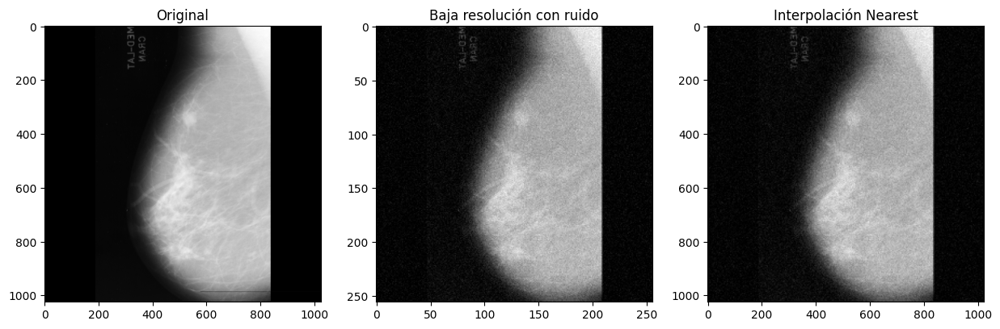

Imagen 1 - PSNR: 27.88, SSIM: 0.4639


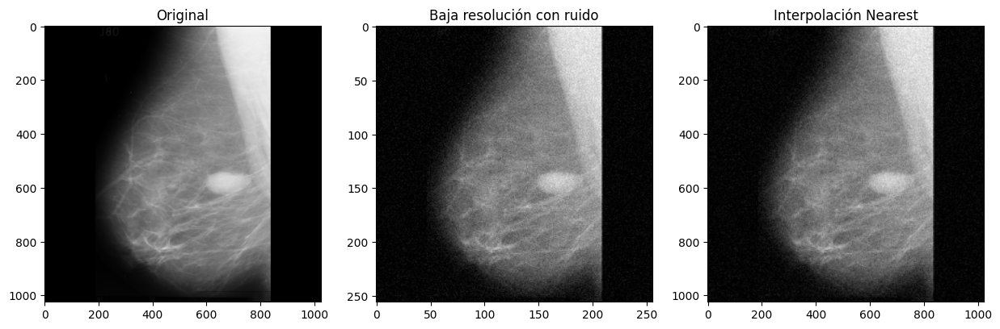

Imagen 2 - PSNR: 27.89, SSIM: 0.4404


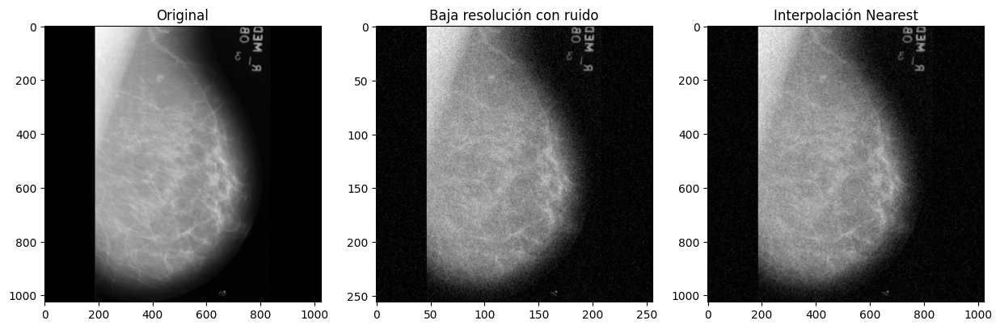

Imagen 3 - PSNR: 29.19, SSIM: 0.4579


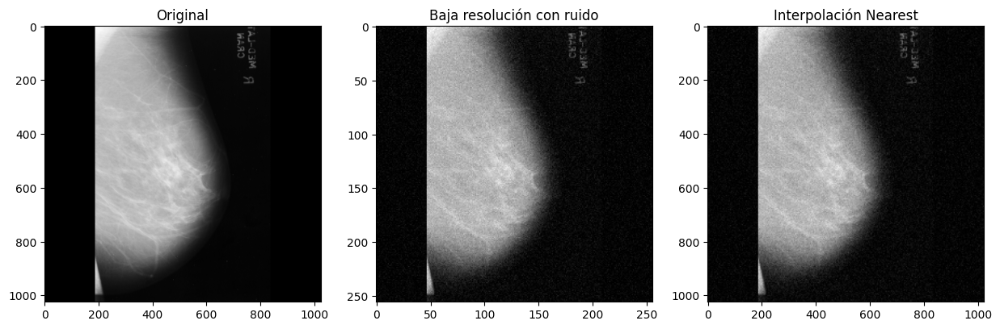

Imagen 4 - PSNR: 29.38, SSIM: 0.4719


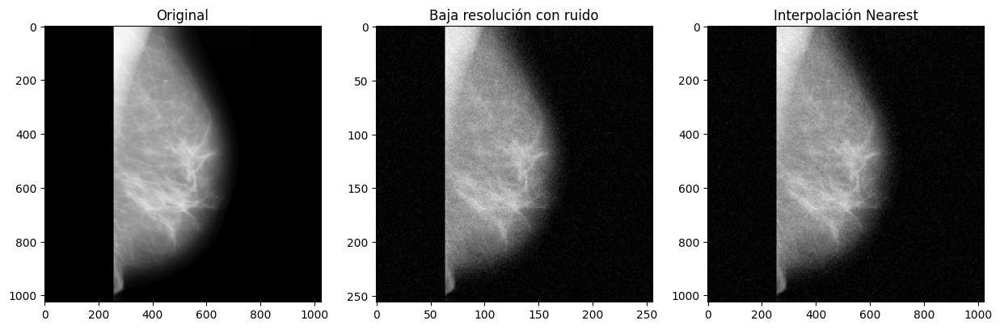

Imagen 5 - PSNR: 30.44, SSIM: 0.3795
PSNR promedio Nearest: 28.96, SSIM promedio Nearest: 0.4427

Evaluando método de interpolación: Linear


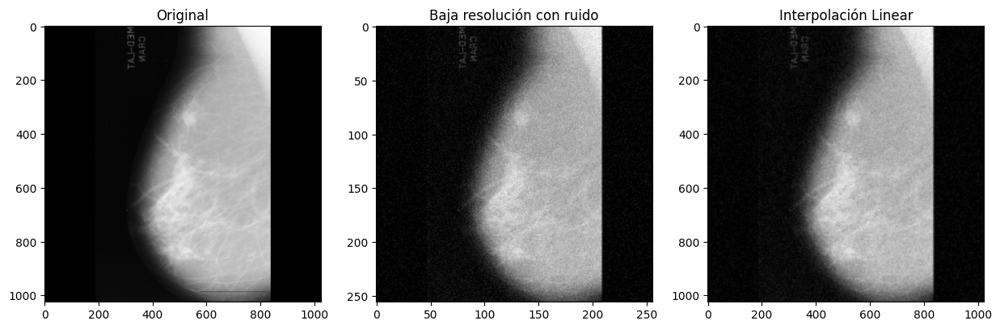

Imagen 1 - PSNR: 29.91, SSIM: 0.5894


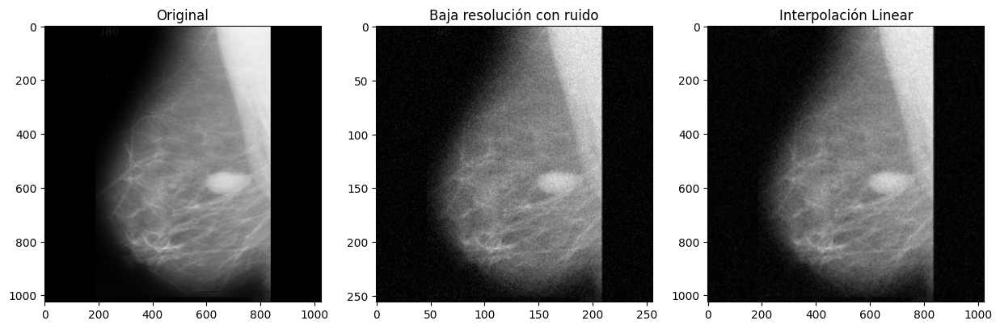

Imagen 2 - PSNR: 29.90, SSIM: 0.5575


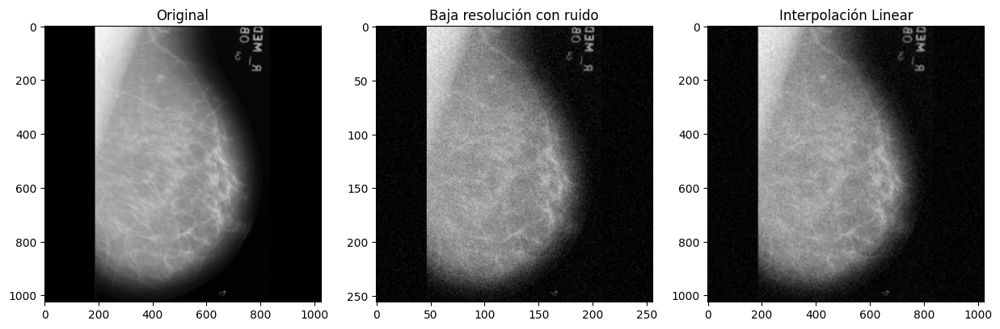

Imagen 3 - PSNR: 31.89, SSIM: 0.5821


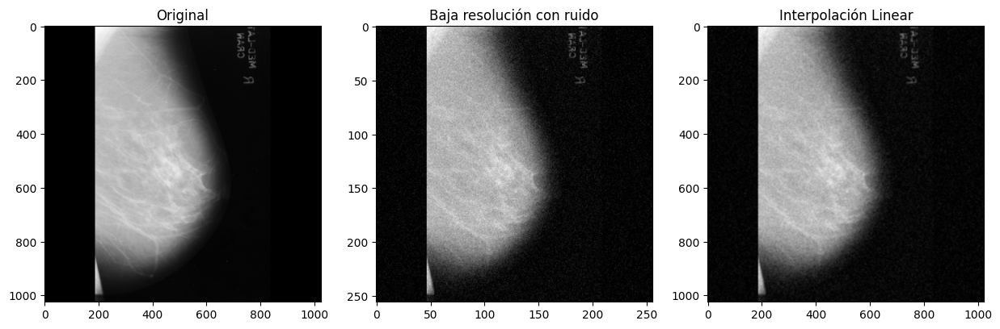

Imagen 4 - PSNR: 32.02, SSIM: 0.5935


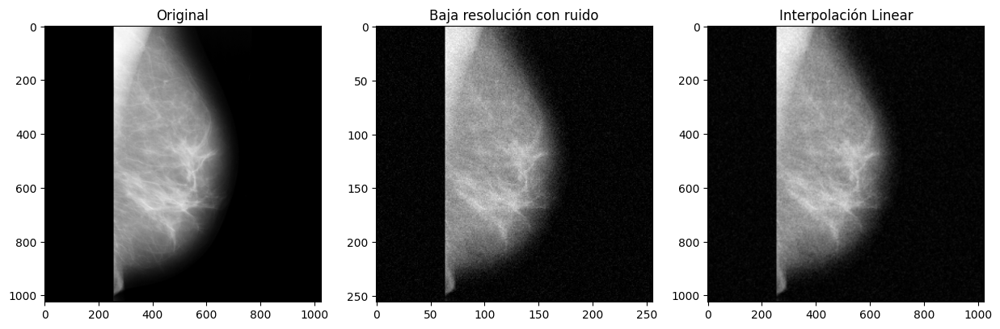

Imagen 5 - PSNR: 32.17, SSIM: 0.4613
PSNR promedio Linear: 31.18, SSIM promedio Linear: 0.5568

Evaluando método de interpolación: Cubic


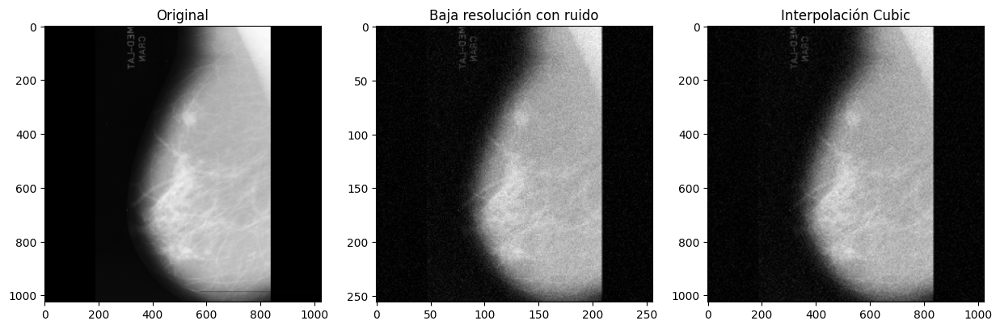

Imagen 1 - PSNR: 29.22, SSIM: 0.5231


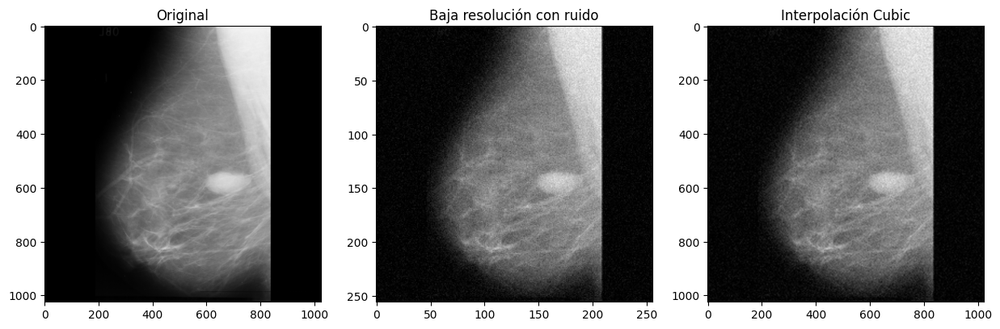

Imagen 2 - PSNR: 29.17, SSIM: 0.4957


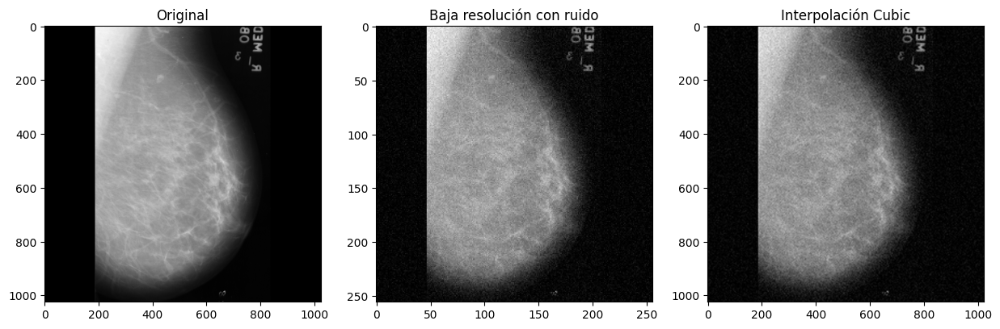

Imagen 3 - PSNR: 30.57, SSIM: 0.5161


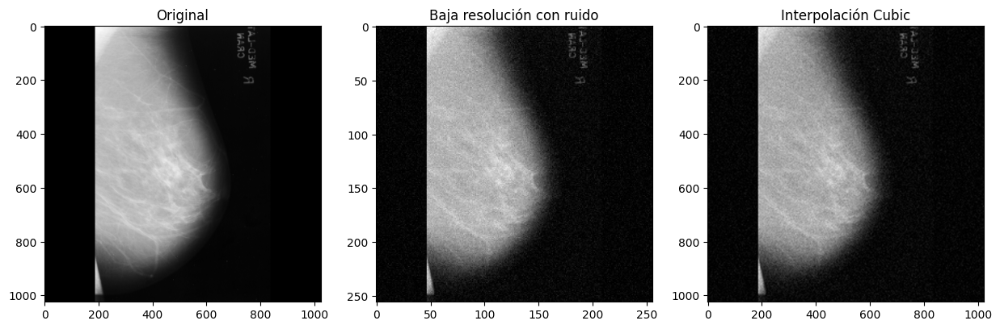

Imagen 4 - PSNR: 30.74, SSIM: 0.5287


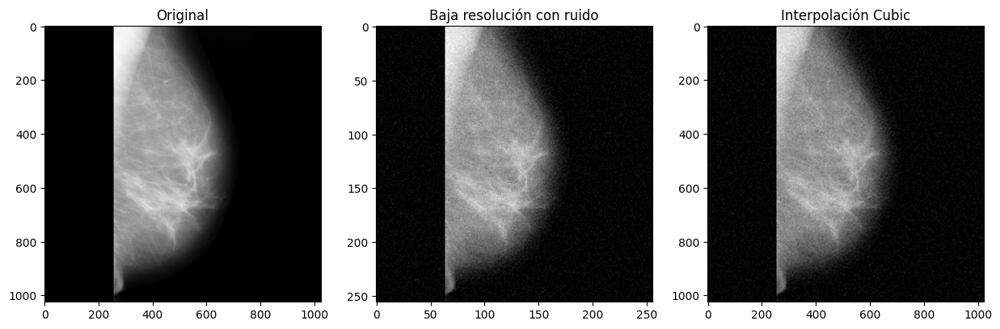

Imagen 5 - PSNR: 30.95, SSIM: 0.4134
PSNR promedio Cubic: 30.13, SSIM promedio Cubic: 0.4954

Evaluando método de interpolación: Lanczos4


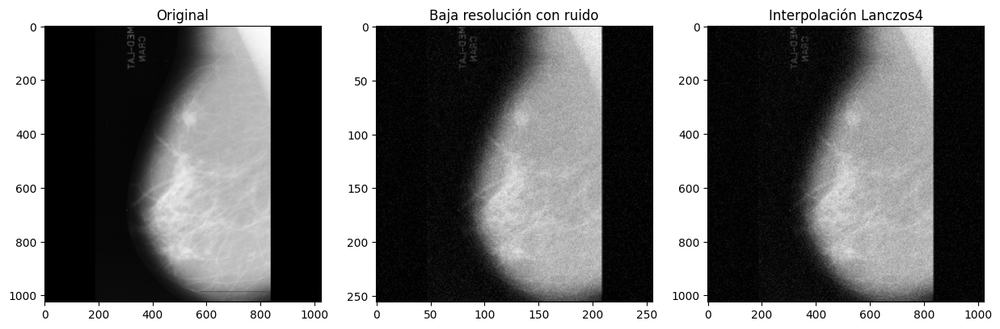

Imagen 1 - PSNR: 28.97, SSIM: 0.4980


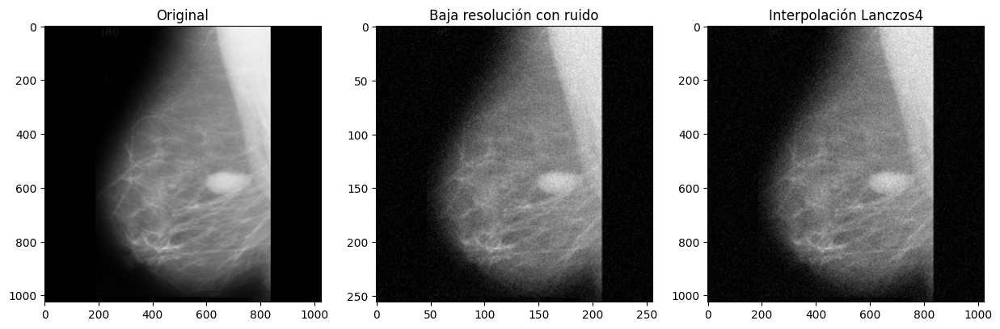

Imagen 2 - PSNR: 28.90, SSIM: 0.4700


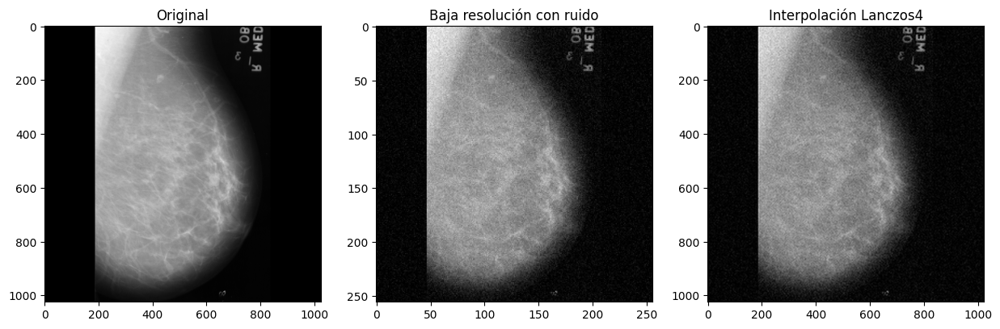

Imagen 3 - PSNR: 30.16, SSIM: 0.4890


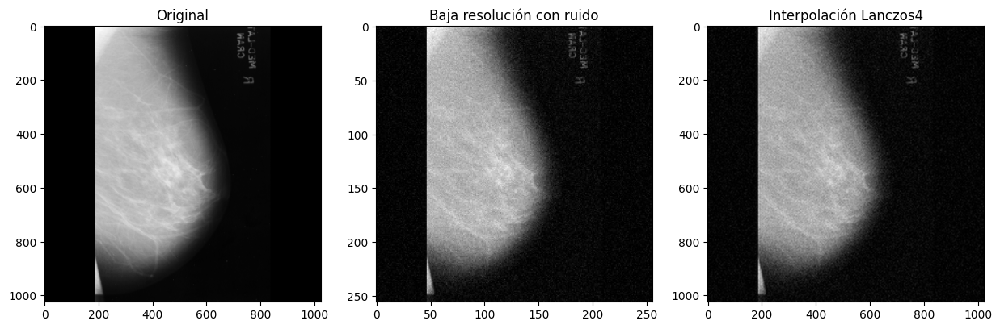

Imagen 4 - PSNR: 30.35, SSIM: 0.5032


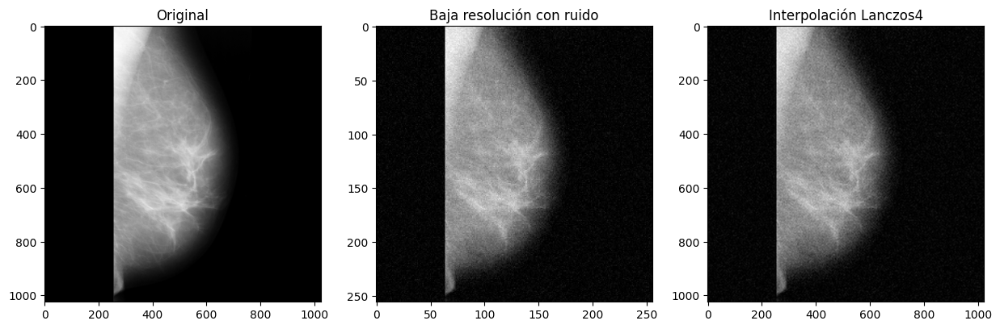

Imagen 5 - PSNR: 30.57, SSIM: 0.3897
PSNR promedio Lanczos4: 29.79, SSIM promedio Lanczos4: 0.4700



In [8]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Directorio de imágenes
data_dir = "mias/all-mias/"

# Cargar imágenes
images = []
for file_name in os.listdir(data_dir):
    if file_name.endswith('.pgm'):
        img_path = os.path.join(data_dir, file_name)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        images.append(img)

# Normalización y preparación
images = np.array(images)
images = images.astype('float32') / 255.0

# Convertir imágenes en escala de grises a imágenes RGB
val_images = images[:10]
val_images_rgb = [np.stack((img,)*3, axis=-1) for img in val_images]

# Realizar la bajada de resolución
val_images_resized = [cv2.resize(img, (img.shape[1]//4, img.shape[0]//4)) for img in val_images_rgb]

# Añadir ruido gaussiano a las imágenes de baja resolución
noise_std = 0.05
val_images_noisy = [img + noise_std * np.random.randn(*img.shape) for img in val_images_resized]
val_images_noisy = np.clip(val_images_noisy, 0, 1)  # Asegurarse de que los valores estén en el rango [0, 1]

# Convertir imágenes a uint8 para OpenCV
val_images_noisy_uint8 = [np.uint8(img * 255) for img in val_images_noisy]

# Métodos de interpolación en OpenCV
interpolation_methods = {
    "Nearest": cv2.INTER_NEAREST,
    "Linear": cv2.INTER_LINEAR,
    "Cubic": cv2.INTER_CUBIC,
    "Lanczos4": cv2.INTER_LANCZOS4
}

# Realizar la interpolación y la comparación
for method_name, method in interpolation_methods.items():
    print(f"Evaluando método de interpolación: {method_name}")

    psnr_values = []
    ssim_values = []

    interpolated_images = [cv2.resize(img, (img.shape[1]*4, img.shape[0]*4), interpolation=method) for img in val_images_noisy_uint8]

    for i in range(5):
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.imshow(val_images[i], cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title('Baja resolución con ruido')
        plt.imshow(cv2.cvtColor(val_images_noisy_uint8[i], cv2.COLOR_BGR2GRAY), cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title(f'Interpolación {method_name}')
        plt.imshow(cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY), cmap='gray')
        plt.show()

        # Calcular PSNR y SSIM
        original_img = (val_images[i] * 255).astype(np.uint8)
        interpolated_img_gray = cv2.cvtColor(interpolated_images[i], cv2.COLOR_BGR2GRAY)

        psnr_value = compare_psnr(original_img, interpolated_img_gray)
        ssim_value = compare_ssim(original_img, interpolated_img_gray)

        psnr_values.append(psnr_value)
        ssim_values.append(ssim_value)

        print(f'Imagen {i+1} - PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')

    # Mostrar los valores promedio de PSNR y SSIM
    average_psnr = np.mean(psnr_values)
    average_ssim = np.mean(ssim_values)
    print(f'PSNR promedio {method_name}: {average_psnr:.2f}, SSIM promedio {method_name}: {average_ssim:.4f}\n')

x4 0.05 sin ruido